P6: Classifiez automatiquement des biens de consommation

# Librairies

In [1]:
# builtin
import os
# datetime 
import datetime as dt
import pandas as pd
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
#Display image directly on the notebook 
%matplotlib inline 
# Render and Display images on the notebook
from IPython.display import Image 

import PIL
import PIL.Image
import tensorflow as tf
import tensorflow_datasets as tfds
from sklearn import manifold, decomposition
from keras import models
from IPython.display import Image, display
import time
from tqdm import tqdm
from keras.preprocessing import image
import sklearn as sk
from sklearn import cluster, metrics

In [2]:
from mes_fonction import *

In [65]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings('ignore')

In [4]:

from PIL import Image as im
from sklearn import cluster, metrics
from sklearn import manifold, decomposition
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.metrics import adjusted_rand_score
from sklearn import manifold, decomposition
import PIL 
print('Pillow Version :', PIL.__version__)

Pillow Version : 9.4.0


In [5]:
from sklearn.model_selection import train_test_split

In [6]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


# Function

In [7]:
# Display une image 
def display_image(a, titre = "Original"):
    """
    Attributs : 
    -----------
    a : path de l'image
    titre : titre de la photo
    
    Returns:
    Display l'image 
    """
    plt.imshow(a), plt.title(titre)
    plt.xticks([]), plt.yticks([])
    plt.show()

In [8]:
def path_image(path, image_index):
    """
    Attributs : 
    -----------
    path : Chemin du dossier qui contient les photos.
    image_index : index de l'image ou numéro d'un image.
    
    returns:
    --------
    Cette Fonction retourne le chemin complet pour accèder à l'image N° : image_index
    """
    
    liste_nom_image = os.listdir(path)
    image_path = path + liste_nom_image[image_index]
    return image_path

In [9]:
def plot_tsne_clusters(X_tsne, clusters, categories_column):
    
    """
    Attributs : 
    -----------
    X_tsne : array des résultat de la réduction de dimension par TsNE
    clusters : résultats de clusters par KMeans sur les résultats de la TsNE
    categories_column : Les vraies catégories dont nous disposons. 
    
    Returns : 
    ---------
    Plot deux graphiques Résultats TSNE et Résultas du KMeans pour comparaison. 
    """
    
    df_tsne = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
    df_tsne["product_category"] = categories_column
    df_tsne["cluster"] = clusters
    
    palette=generate_colors(7, palette='colorblind')

    
    plt.figure(figsize=(15,5))
    plt.subplot(121)

    sns.scatterplot(
        x="tsne1", y="tsne2", hue="product_category", data=df_tsne, legend="brief",
        palette=palette, s=50, alpha=0.6)

    plt.title('Catégories réelles t-SNE', fontweight = 'bold')
    plt.xlabel('x1')
    plt.ylabel('x2')
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')

    plt.subplot(122)

    sns.scatterplot(
        x="tsne1", y="tsne2", hue="cluster", data=df_tsne, legend="brief",
        palette=palette, s=50, alpha=0.6)

    plt.title('Kmeans clusters t-SNE', fontweight = 'bold')
    plt.xlabel('x1')
    plt.ylabel('x2')
    plt.legend(bbox_to_anchor=(1, 1), loc='upper left')

    plt.tight_layout(pad=2)
    plt.show()

In [10]:
# Fonction pour générer les couleurs pour les cluster
def generate_colors(num_clusters, palette='colorblind'):
    
    """
    Selon le nombre de Cluster : num_cluster, on vas générer des couleurs au format hex.
    
    deep, muted, bright, pastel, dark, colorblind
    """
    
    colors = color = sns.color_palette(palette= palette, n_colors= num_clusters, desat=None, as_cmap=False).as_hex()
    return colors

In [11]:
def calcul_tsne_ari(df_train_bow, pr_l, lr_r, n_c, to_array=False, categories_column=None):
    
    """
    Fonction pour Calculer L'ARI entre les vraie catégories et les catégories trouvées par KMeans
    Calculer les deux composantes de la TSNE et retourner les résultats. 
    """
    
    if to_array:
        df_train_bow = df_train_bow.toarray()
        
    tsne = TSNE(n_components=2, perplexity=pr_l, learning_rate=lr_r, 
                n_iter=2000,  init='random', random_state= 0)
    
    kmeans = KMeans(n_clusters= n_c, max_iter= 300, n_init= 10,init= 'k-means++', algorithm= 'auto' )
    X_tsne = tsne.fit_transform(df_train_bow)
    kmeans.fit(X_tsne)
    ARI = adjusted_rand_score(categories_column.values, kmeans.labels_)
    print("ARI : ", ARI)
    return ARI, X_tsne, kmeans.labels_

In [12]:
def fine_tune_tsne_parametre(PERPLEX, LR, cls, train, to_array=False):
    
    """
    Fonction pour fine tuner les paramètre Learning rate et Perplexity de la TSNE 
    Retourner : un df de comparaion pour différentes valeurs de ces paramètres. 
    """
    
    if to_array:
        train = train.toarray() 
    
    
    learning_rate_ = []
    perplexity_ = []
    TIME_ = []
    ARI_ = []
    i = 0
    for perplex in PERPLEX:
        for lr in LR:
            progress = (i + 1) * 4
            tsne = manifold.TSNE(n_components=2,
                         perplexity=perplex,
                         learning_rate=lr,
                         n_iter=2000,
                         init='random',
                         random_state= 0)
            time1 = time.time()
            X_tsne = tsne.fit_transform(train)
            df_tsne2 = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
            df_tsne2["product_category"] = data["product_category_1"]
            labels = df_tsne2["product_category"].values
            cls.fit(X_tsne)
            ARI = adjusted_rand_score(labels, cls.labels_)
            time2 = np.round(time.time() - time1,0)

            #-----Append----: 
            learning_rate_.append(lr)
            perplexity_.append(perplex)
            ARI_.append(ARI)
            TIME_.append(time2)
            print(f"[{'#' * (i + 1)}{' ' * (24 - i)}] {progress}% completed", end="\r")
#             print(f"Processing... {progress}% complete", end="")
            i+=1
            
            
    eval_df = pd.DataFrame({
        "learning_rate": learning_rate_,
        "perplexity" : perplexity_,
        "TIME_": TIME_,
        "ARI_": ARI_,
    })
    
    return eval_df.sort_values(by='ARI_',ascending=False)

# Import Data

In [13]:
os.listdir("data/source/") 

['data_image_product',
 'flipkart_com-ecommerce_sample_1050.csv',
 'meteo_data_set',
 'P6_images_data_set']

In [14]:
os.listdir("data/cleaned") 

['cleaned_data_to_analize_dataset.csv',
 'cleaned_data_to_vectorize_dataset.csv',
 'special_tokens_map.json',
 'tokenizer.json',
 'tokenizer_config.json',
 'vocab.txt']

In [15]:
path = "./data/cleaned/"
filename = "cleaned_data_to_vectorize_dataset.csv"
data = pd.read_csv(path + filename)
data.head()

,uniq_id,product_category_1,image,description_bow,description_bow_lem
0,55b85ea15a1536d46b7190ad6fff8ce7,Home Furnishing,55b85ea15a1536d46b7190ad6fff8ce7.jpg,key features elegance polyester multicolor abs...,key feature elegance polyester multicolor abst...
1,7b72c92c2f6c40268628ec5f14c6d590,Baby Care,7b72c92c2f6c40268628ec5f14c6d590.jpg,specifications sathiyas cotton bath towel bath...,specification sathiyas cotton bath towel bath ...
2,64d5d4a258243731dc7bbb1eef49ad74,Baby Care,64d5d4a258243731dc7bbb1eef49ad74.jpg,key features eurospa cotton terry face towel s...,key feature eurospa cotton terry face towel se...
3,d4684dcdc759dd9cdf41504698d737d8,Home Furnishing,d4684dcdc759dd9cdf41504698d737d8.jpg,key features santosh royal fashion cotton prin...,key feature santosh royal fashion cotton print...
4,6325b6870c54cd47be6ebfbffa620ec7,Home Furnishing,6325b6870c54cd47be6ebfbffa620ec7.jpg,key features jaipur print cotton floral king s...,key feature jaipur print cotton floral king si...


In [16]:
rapport_df(data)

Le Taux de remplissage total est égal à : 100.0 %
Le Nombre de features vides est égal à : 0 Features
Les Features vides sont : []

*****Nombre de catégorie features catégorielles******

uniq_id------------------------------------------- 1050
product_category_1-------------------------------- 7
image--------------------------------------------- 1050
description_bow----------------------------------- 983
description_bow_lem------------------------------- 982


In [19]:
data['image'][0]

'55b85ea15a1536d46b7190ad6fff8ce7.jpg'

In [20]:
# Chemin vers les données images
os.path.abspath('data/source/P6_images_data_set')

'C:\\Users\\Lenovo\\Documents\\DSPython\\P6_Classification\\data\\source\\P6_images_data_set'

In [21]:
# Chemin pour accéder aux images 
path = r'C:\\Users\\Lenovo\\Documents\\DSPython\\P6_Classification\\data\\source\\P6_images_data_set\\'

In [22]:
# Récupération des noms de chauqe images 
liste_nom_image = os.listdir("data/source/P6_images_data_set")
liste_nom_image[2]

'00cbbc837d340fa163d11e169fbdb952.jpg'

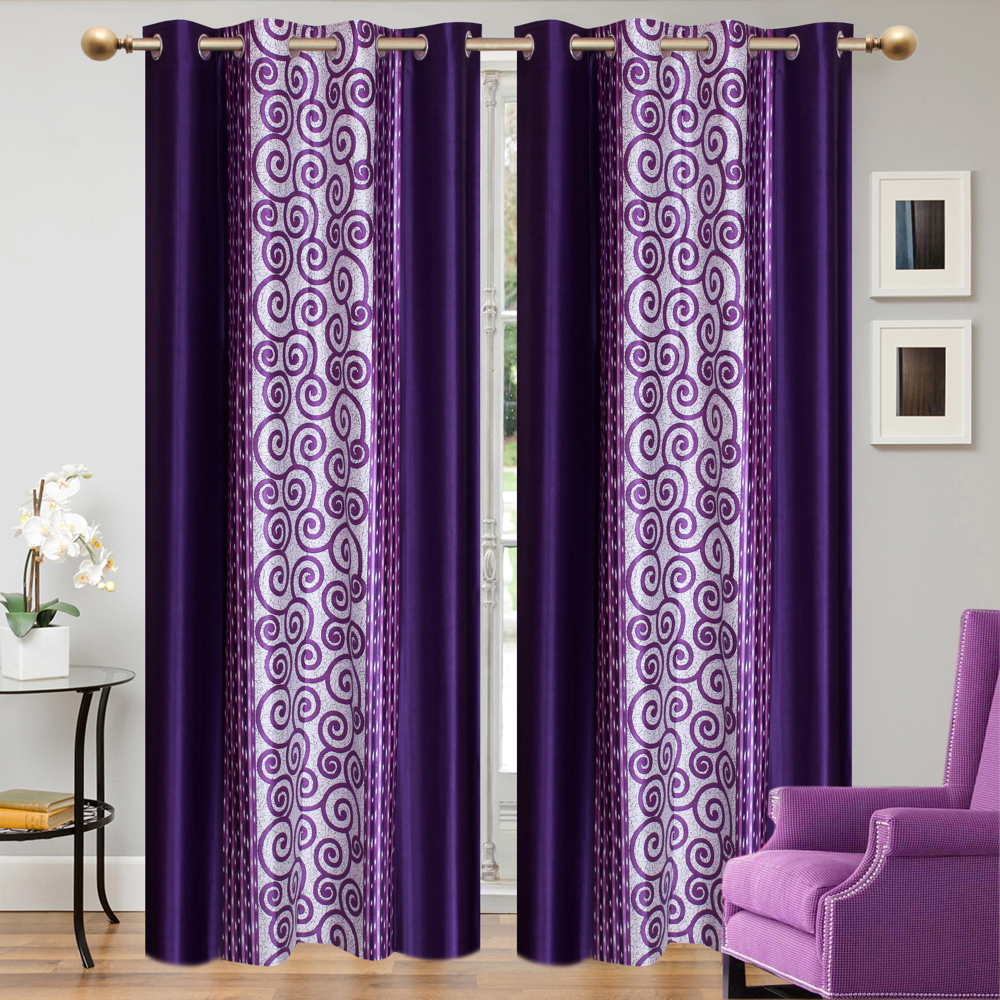

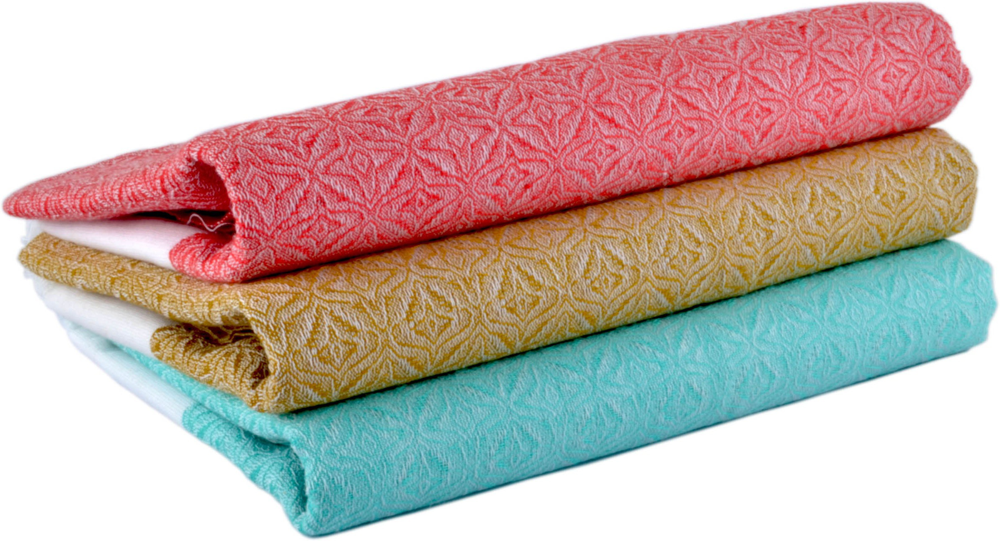

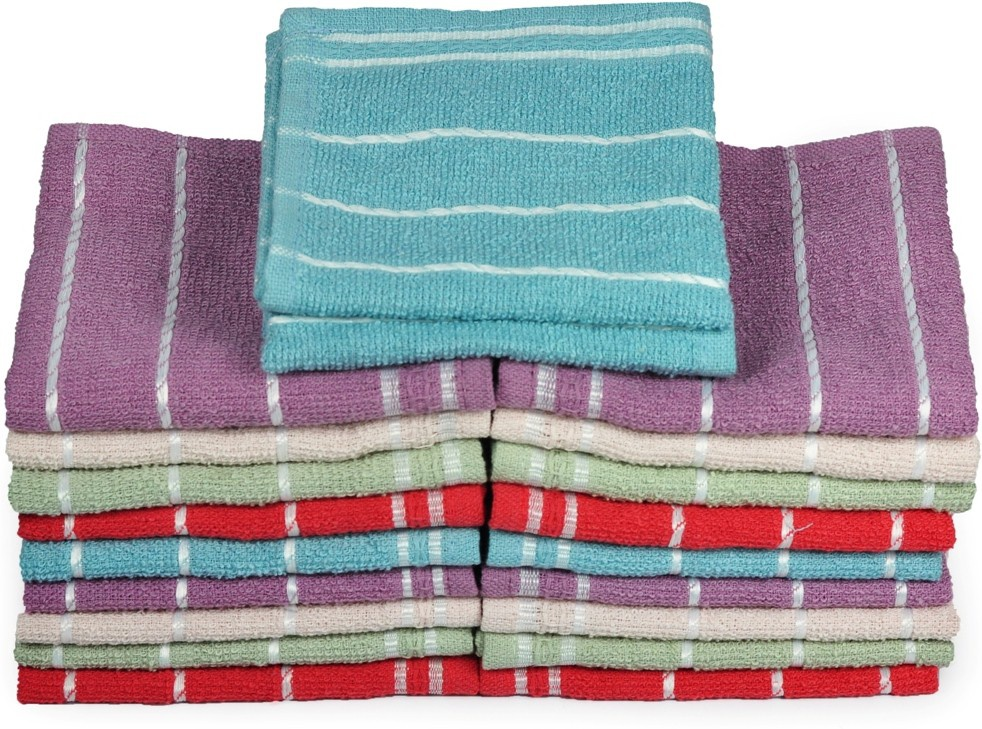

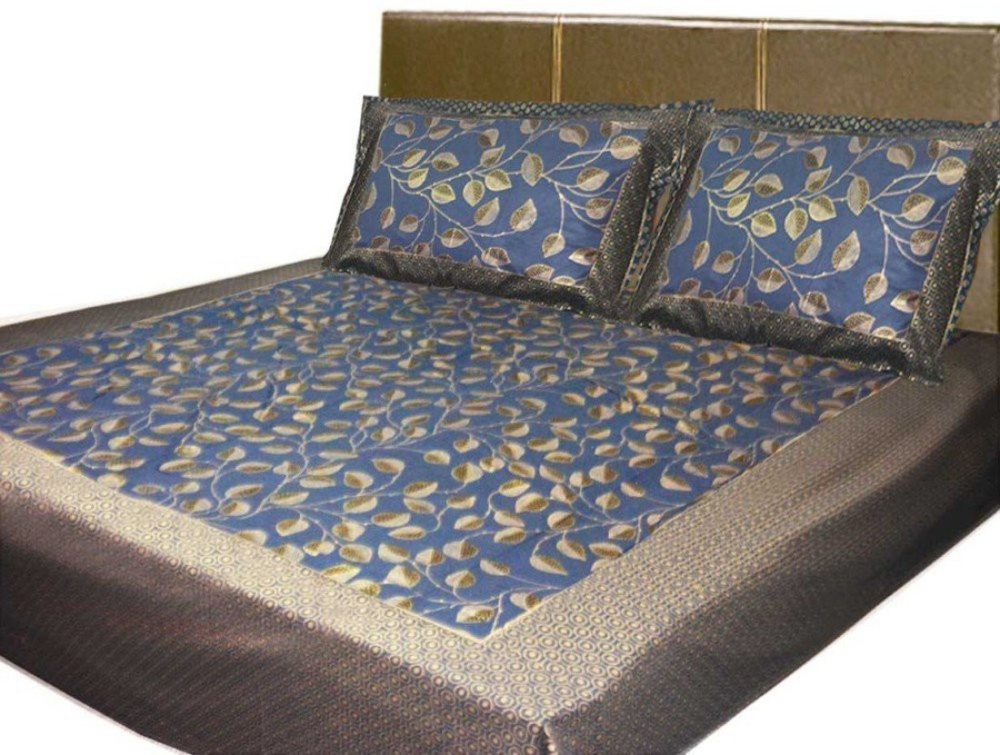

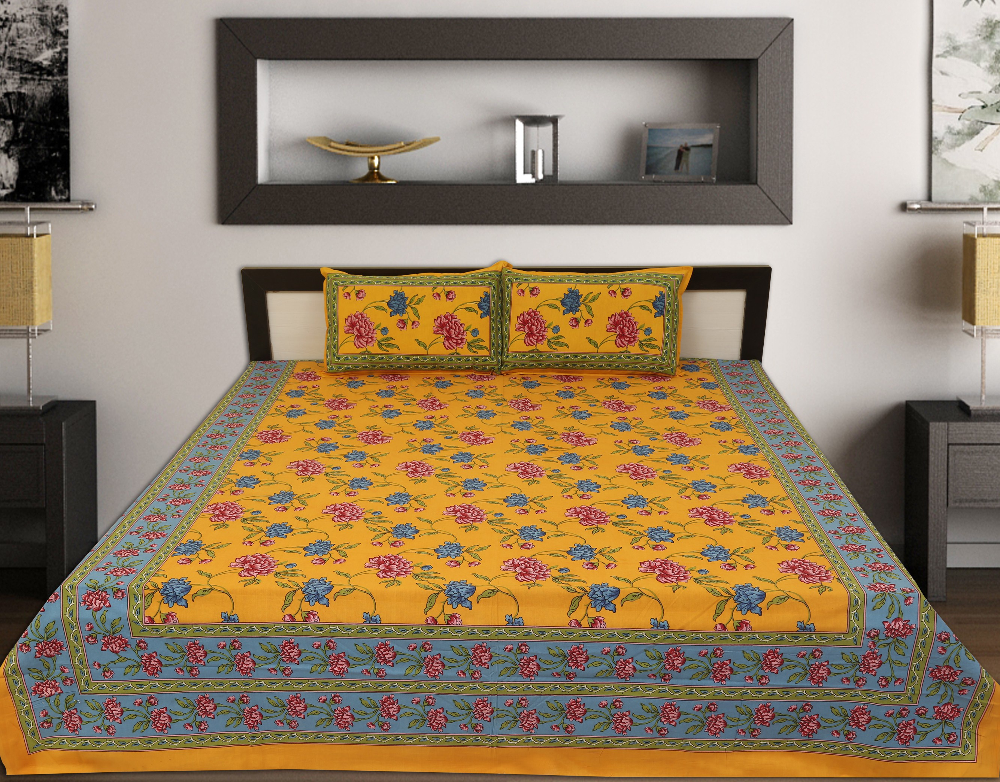

In [23]:
# Display des 5 premières images 
for i in range(5):
    image_path = path + data['image'][i]
    display(Image(filename=image_path))


In [24]:
image_ = path + data['image'][0]
image_

'C:\\\\Users\\\\Lenovo\\\\Documents\\\\DSPython\\\\P6_Classification\\\\data\\\\source\\\\P6_images_data_set\\\\55b85ea15a1536d46b7190ad6fff8ce7.jpg'

In [37]:
path_directory = "C:\\Users\\Lenovo\\Documents\\DSPython\\P6_Classification\\data\\source\\P6_images_data_set\\"
path = "./data/cleaned/"
filename = "cleaned_data_to_vectorize_dataset.csv"
data = pd.read_csv(path + filename)

def read_and_display_image_info(df ,index_image = 0 ,directory=False, dataframe=False, path= path_directory):
    # Première méthode importation depuis un dossier 
    if directory:
        list_images = os.listdir(path)
        return liste_images
    if dataframe:
        image_name = df['image'][index_image]
        image_path = path + image_name
        
    nom_category = df['product_category_1'][index_image]
    
    cb_img = cv2.imread(f"{image_path}",0)
    color_img = cv2.imread(f"{image_path}",1)
    color_image_reversed = color_img[:, :, ::-1]
    
    # Split the image into the B,G,R components
    img_NZ_bgr = cv2.imread(f"{image_path}",cv2.IMREAD_COLOR)
    b,g,r = cv2.split(img_NZ_bgr)
    
    print("Image gray size is :", cb_img.shape)
    print("Image color size is :", img_NZ_bgr.shape)
    print("Data type of image is :", cb_img.dtype)
    print("Catégorie produit :", nom_category)
    
    plt.figure(figsize=[20,10])
    plt.subplot(121)
    plt.imshow(color_image_reversed); plt.title("Color Original");
    plt.subplot(122)
    plt.imshow(cb_img, cmap='gray'); plt.title("gray");
    
    
    # Show the channels
    plt.figure(figsize=[20,10])
    plt.subplot(141);plt.imshow(r,cmap='gray_r')
    plt.title("Red Channel")
    
    plt.subplot(142);plt.imshow(g,cmap='gray_r')
    plt.title("Green Channel")
    
    plt.subplot(143);plt.imshow(b,cmap='gray_r')
    plt.title("Blue Channel")
    
    plt.suptitle("Décomposition de l'image en R,G,B / H,S,V  Merge des trois couleurs", fontsize=16, y = 0.75)
    
    # Merge the individual channels into a BGR image
    imgMerged = cv2.merge((b,g,r))
    # Show the merged output
    plt.subplot(144);plt.imshow(imgMerged[:,:,::-1]);plt.title("Merged Output");
    
    img_hsv = cv2.cvtColor(img_NZ_bgr, cv2.COLOR_BGR2HSV)
    img_NZ_rgb = cv2.cvtColor(img_NZ_bgr, cv2.COLOR_BGR2RGB)
    # Split the image into the B,G,R components
    h,s,v = cv2.split(img_hsv)

    # Show the channels
    plt.figure(figsize=[20,5])
    plt.subplot(141);plt.imshow(h,cmap='gray')
    plt.title("H Channel")
    
    plt.subplot(142);plt.imshow(s,cmap='gray')
    plt.title("S Channel")
    
    plt.subplot(143);plt.imshow(v,cmap='gray')
    plt.title("V Channel")
    
    plt.subplot(144);plt.imshow(img_NZ_rgb)
    plt.title("Original")
    
    return color_image_reversed
   

Image gray size is : (3600, 3600)
Image color size is : (3600, 3600, 3)
Data type of image is : uint8
Catégorie produit : Home Furnishing


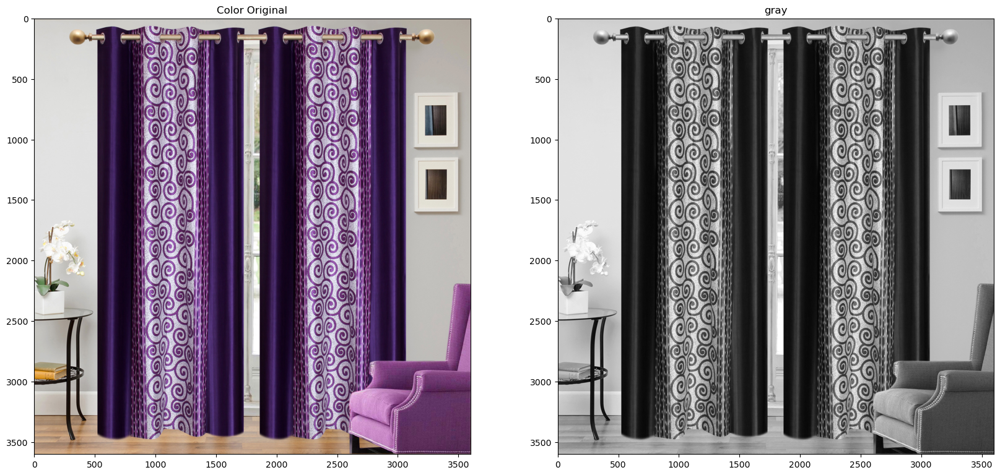

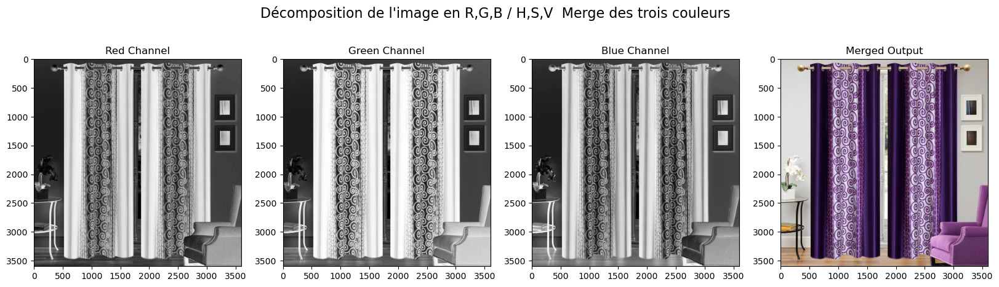

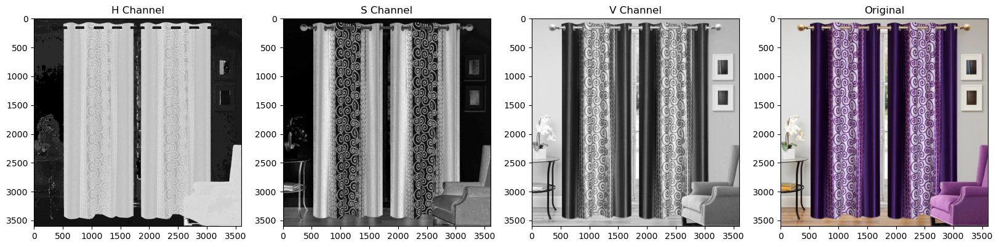

In [38]:
# Exemple image à l'index 0 
color_image_reversed = read_and_display_image_info(df=data ,index_image = 0 ,directory=False, dataframe=True, path= path_directory)

In [27]:
normalization_layer = tf.keras.layers.Rescaling(1./255)

In [28]:
normalized_image = normalization_layer(color_image_reversed)

In [29]:
normalized_image

<tf.Tensor: shape=(3600, 3600, 3), dtype=float32, numpy=
array([[[0.75294125, 0.72156864, 0.6784314 ],
        [0.75294125, 0.72156864, 0.6784314 ],
        [0.7568628 , 0.7254902 , 0.68235296],
        ...,
        [0.68235296, 0.64705884, 0.6117647 ],
        [0.68235296, 0.64705884, 0.6117647 ],
        [0.68235296, 0.64705884, 0.6117647 ]],

       [[0.75294125, 0.72156864, 0.6784314 ],
        [0.7568628 , 0.7254902 , 0.68235296],
        [0.7568628 , 0.7254902 , 0.68235296],
        ...,
        [0.68235296, 0.64705884, 0.6117647 ],
        [0.68235296, 0.64705884, 0.6117647 ],
        [0.68235296, 0.64705884, 0.6117647 ]],

       [[0.75294125, 0.7294118 , 0.68235296],
        [0.7568628 , 0.73333335, 0.6862745 ],
        [0.7568628 , 0.73333335, 0.6862745 ],
        ...,
        [0.6862745 , 0.6509804 , 0.6156863 ],
        [0.68235296, 0.64705884, 0.6117647 ],
        [0.68235296, 0.64705884, 0.6117647 ]],

       ...,

       [[0.8196079 , 0.68235296, 0.53333336],
        [0.

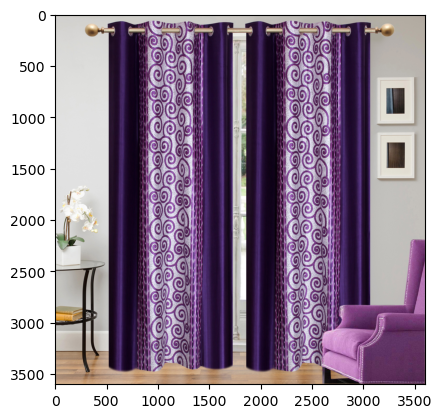

In [30]:
plt.imshow(color_image_reversed)

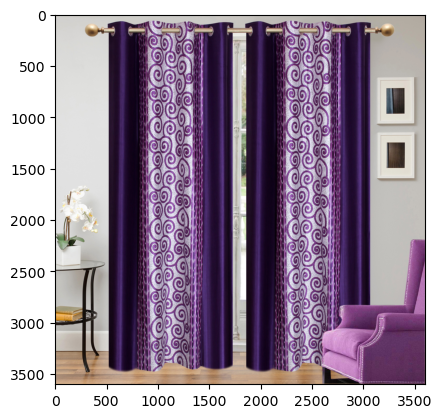

In [297]:
plt.imshow(normalized_image)

In [25]:
# Read image as gray scale.
cb_img = cv2.imread(f"{image_}",0)

# Print the image data (pixel values), element of a 2D numpy array.
# Each pixel value is 8-bits [0,255]
print(cb_img)

[[185 185 186 ... 167 167 167]
 [185 186 186 ... 167 167 167]
 [186 187 187 ... 168 167 167]
 ...
 [180 180 180 ... 105 109 114]
 [181 181 181 ... 115 118 122]
 [181 181 181 ... 124 126 129]]


In [26]:
# print the size  of image
print("Image size is ", cb_img.shape)

# print data-type of image
print("Data type of image is ", cb_img.dtype)

Image size is  (3600, 3600)
Data type of image is  uint8


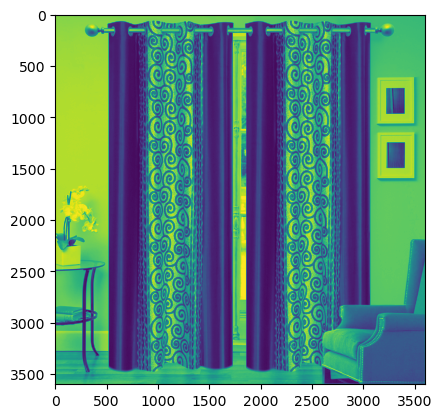

In [27]:
# Display image.
plt.imshow(cb_img)

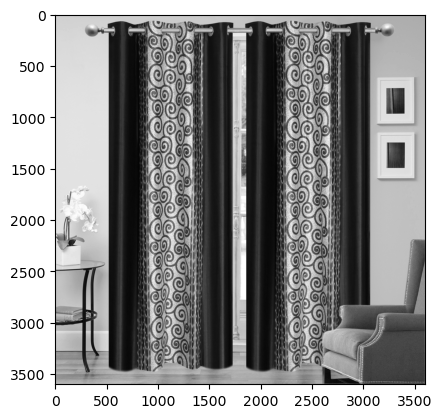

In [28]:
# Set color map to gray scale for proper rendering.
plt.imshow(cb_img, cmap='gray')

[[185 185 186 ... 167 167 167]
 [185 186 186 ... 167 167 167]
 [186 187 187 ... 168 167 167]
 ...
 [180 180 180 ... 105 109 114]
 [181 181 181 ... 115 118 122]
 [181 181 181 ... 124 126 129]]
Image size is  (3600, 3600)


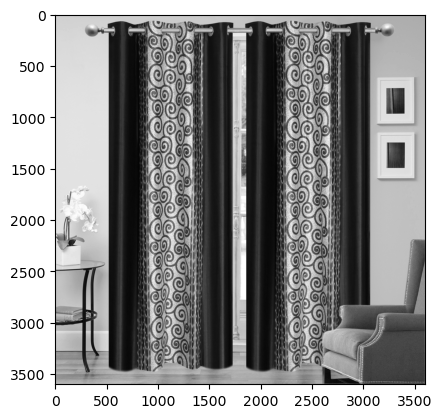

In [28]:
# Read image as gray scale.
cb_img = cv2.imread(f"{image_}",0)
print(cb_img)
print("Image size is ", cb_img.shape)

plt.imshow(cb_img, cmap='gray')

[[[173 184 192]
  [173 184 192]
  [174 185 193]
  ...
  [156 165 174]
  [156 165 174]
  [156 165 174]]

 [[173 184 192]
  [174 185 193]
  [174 185 193]
  ...
  [156 165 174]
  [156 165 174]
  [156 165 174]]

 [[174 186 192]
  [175 187 193]
  [175 187 193]
  ...
  [157 166 175]
  [156 165 174]
  [156 165 174]]

 ...

 [[136 174 209]
  [136 174 209]
  [136 174 209]
  ...
  [ 96  94 130]
  [ 97  99 134]
  [100 104 139]]

 [[137 175 210]
  [137 175 210]
  [137 175 210]
  ...
  [103 105 140]
  [102 108 143]
  [104 113 147]]

 [[137 175 210]
  [137 175 210]
  [137 175 210]
  ...
  [110 114 149]
  [108 117 151]
  [110 120 154]]]


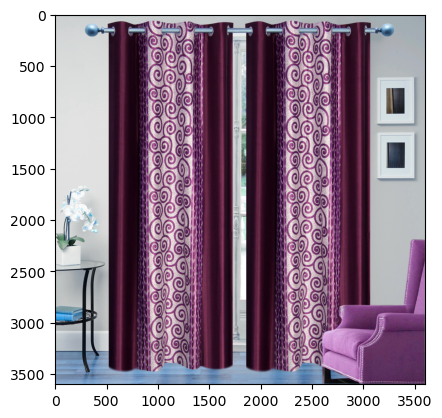

In [33]:
# Read image as gray scale.
color_img = cv2.imread(f"{image_}",1)
print(color_img)
plt.imshow(color_img)

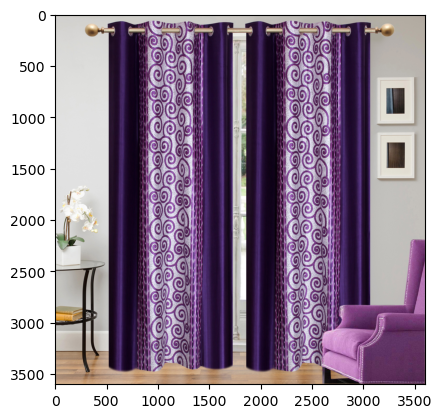

In [34]:
coke_img_channels_reversed = color_img[:, :, ::-1]
plt.imshow(coke_img_channels_reversed)

In [42]:
img_hsv = cv2.cvtColor(coke_img_channels_reversed, cv2.COLOR_BGR2HSV)
img_NZ_rgb = cv2.cvtColor(coke_img_channels_reversed, cv2.COLOR_BGR2RGB)
# Split the image into the B,G,R components
h,s,v = cv2.split(img_hsv)

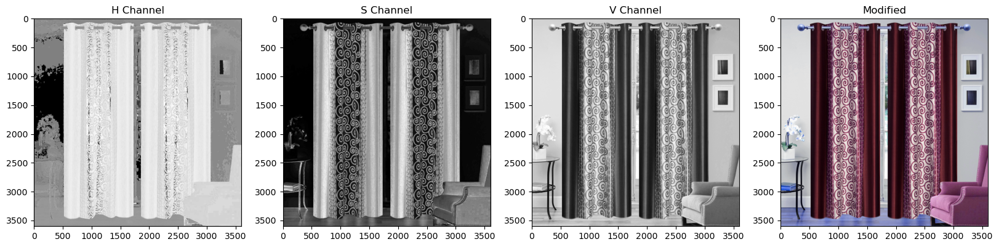

In [43]:
h_new = h+10
img_NZ_merged = cv2.merge((h_new,s,v))
img_NZ_rgb = cv2.cvtColor(img_NZ_merged, cv2.COLOR_HSV2RGB)

# Show the channels
plt.figure(figsize=[20,5])
plt.subplot(141);plt.imshow(h,cmap='gray');plt.title("H Channel");
plt.subplot(142);plt.imshow(s,cmap='gray');plt.title("S Channel");
plt.subplot(143);plt.imshow(v,cmap='gray');plt.title("V Channel");
plt.subplot(144);plt.imshow(img_NZ_rgb);plt.title("Modified");
# Save Figure:
name = "Exemple_images"
plt.savefig(f"figures/{name}.png", transparent=True, bbox_inches='tight', dpi=200)

In [35]:
# read the image as Color
img_NZ_bgr = cv2.imread(f"{image_}", cv2.IMREAD_COLOR)
print("img_NZ_bgr shape is: ", img_NZ_bgr.shape)

# read the image as Grayscaled
img_NZ_gry = cv2.imread(f"{image_}", cv2.IMREAD_GRAYSCALE)
print("img_NZ_gry shape is: ", img_NZ_gry.shape)

img_NZ_bgr shape is:  (3600, 3600, 3)
img_NZ_gry shape is:  (3600, 3600)


# PIL

In [298]:
img = im.open(f"{image_}")

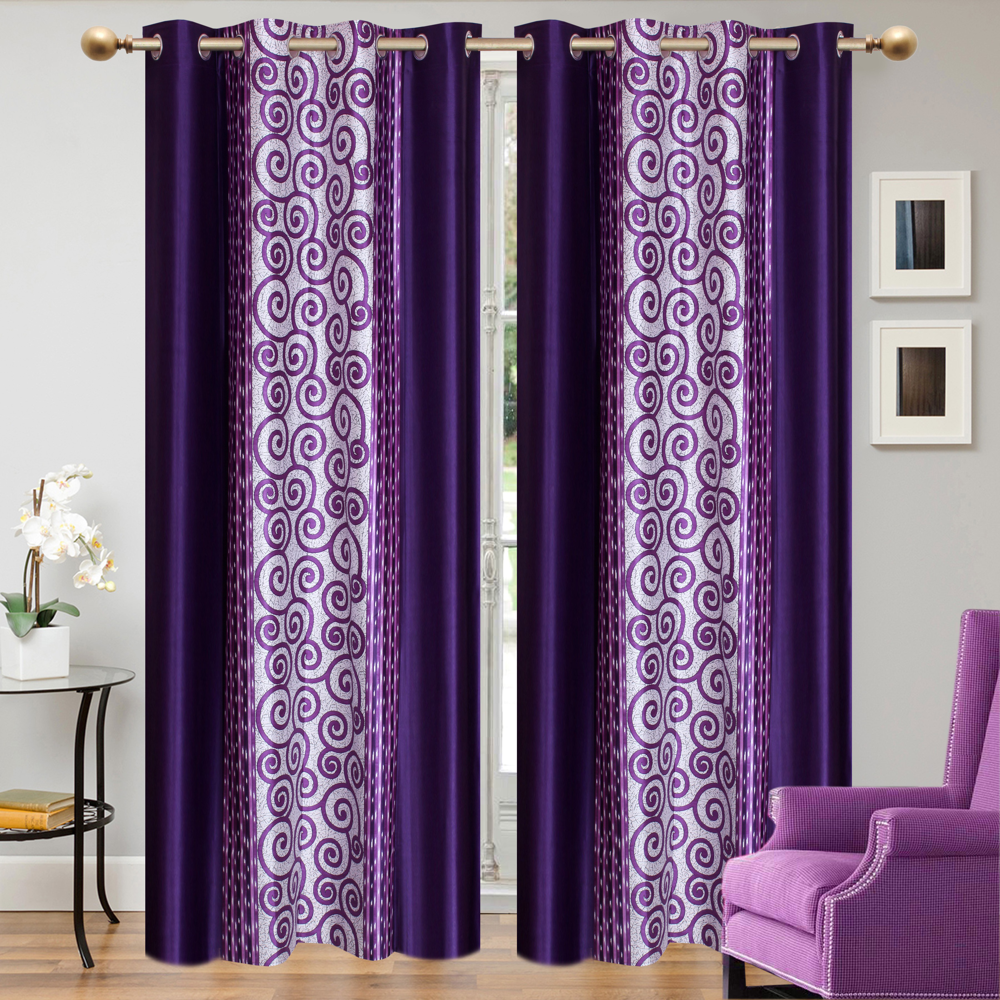

In [299]:
img

In [300]:
str(img.mode)

'RGB'

In [301]:
print(img.format, img.size, img.mode)

JPEG (3600, 3600) RGB


In [302]:
box = (0, 3600, 0,3600)
region = img.crop(box)

In [303]:
img = np.array(img)

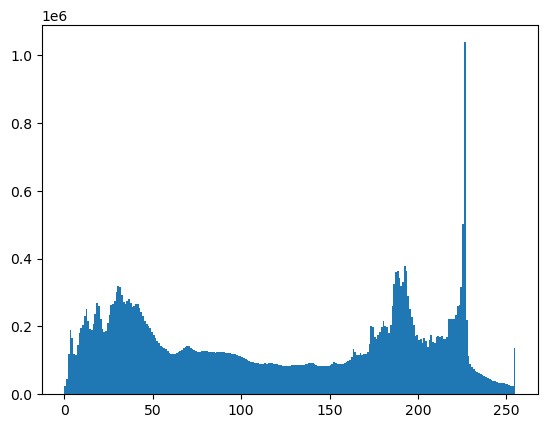

In [304]:
n, bins, patches = plt.hist(img.flatten(), bins=range(256))
plt.show()

# Feature Extraction

La détection de features, implique de trouver des points clés (key points) ou bien des structures distinctives dans une image. 
Ces points clés (key points), sont souvent appelés caractéristiques ou points d'intérêt. Comme exemples : les coins d'une image, les bords d'une image, ou bien une surface plane de l'image. Le mécanisme général pour détecter les features, c'est de rechercher les régions de l'image qui présentent une variation maximale lorsque'elles sont déplacées (d'une petite quantité) dans toutes les régions qui les entourent. [Voir la définition Doc OpenCV](https://docs.opencv.org/3.4/df/d54/tutorial_py_features_meaning.html)

## Bag of images : SIFT

L'algorithme SIFT (Scale-Invariant Feature Transform), est un algorithme de vision par ordinateur (CV) utiliser pour détecter et décrire (avec des descripteurs) les features locales dans une image. SIFT fonctionne de la façon suivante : 
- détection des (key points) dans une image, qui sont des régions de l'image distinctes et invariantes aux changements d'échelle, de rotation, et d'éclairage.
- une fois les key points détectés, SIFT extrait un descripteur local pour chaque point clé. Le descripteur est calculé sur la base de l'amplitude du gradient et de l'orientation des pixels dans un voisinage local autour du point clé. Le descripteur résultant est un vecteur qui représente l'apprence du point clé et qui est invariant aux changement d'échelle, de rotation, et d'illumination. 

In [49]:
def compute_key_points_display_image(path, 
                                     methode=None,
                                     data=None, image_index = 0, return_kp_des=False, plot=False, nfeatures=0):
    
    
    if methode == "liste_name_images":
        liste_nom_image = os.listdir(path)
        # Avec la liste des nom d'images : 
        image_path = path + liste_nom_image[image_index]        
    
    if methode == "index_image":
        image_path = path + data['image'][image_index]
        
    # 1- Lecture de l'image 
    image_color_gbr = cv2.imread(f"{image_path}",1)
    
    # Resizin
    height, width, channels = image_color_gbr.shape
    new_height = 500
    new_width = int(width * (new_height/height))
    resized = cv2.resize(image_color_gbr, (new_width, new_height), interpolation = cv2.INTER_LINEAR)
    
    
    
    # 2- Pre-Processing : 
    
    # passage au gris
    gray = cv2.cvtColor(resized, cv2.COLOR_BGR2GRAY)
    
    # normalisation
    equalized_image = cv2.equalizeHist(gray)
    
#     # blur
#     blur = cv2.GaussianBlur(equalized_image, (0,0), sigmaX=33, sigmaY=33)
    
#     # divide
#     divide = cv2.divide(equalized_image, blur, scale=255)
    
#     # otsu threshold
#     thresh = cv2.threshold(divide, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]
    
#     # apply morphology
#     kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
#     morph = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
    
    # 3- Création d'un objet SIFT
    sift = cv2.SIFT_create()
    
    if nfeatures !=0:
        sift = cv2.SIFT_create(nfeatures)
    
    # 4- Détection des Key Points et Calcul des Descripteurs 
    keypoints, descriptors  = sift.detectAndCompute(equalized_image, None)
    
    
    
    
    if plot:
        
        # 5- Dessiner les KeyPoints sur l'image d'origine
        image_key_points = cv2.drawKeypoints(equalized_image, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        
        # 6- Display de l'image, des key points et d'un zoom (pour plus de lisibilité)
        # Zone de zoome 
        zoom_region = [200, 300, 200, 300]

        # Figure et subplots 
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

        # Image d'origine 
        ax1.imshow(image_key_points)
        ax1.set_title('Full Image')

        # Zoom
        ax2.imshow(cv2.cvtColor(image_key_points[zoom_region[0]:zoom_region[1], zoom_region[2]:zoom_region[3]], cv2.COLOR_BGR2RGB))
        ax2.set_title('Zoomed-In Region')
        name = "Features_exemple_1"
        plt.savefig(f"figures/{name}.png", transparent=True, bbox_inches='tight', dpi=200)
        plt.show()
    
    
    if return_kp_des:
        return descriptors

In [50]:
# Chemin pour accéder aux images 
path = r'C:\\Users\\Lenovo\\Documents\\DSPython\\P6_Classification\\data\\source\\P6_images_data_set\\'

descriptors = compute_key_points_display_image(path, 
                                                          methode= "liste_name_images", 
                                                          data=None, 
                                                          image_index = 15, 
                                                          return_kp_des=True,
                                                          plot=False,
                                                          nfeatures=0
                                                         )
print(f"L'image comporte {descriptors.shape[0]} descripteur de longuer {descriptors.shape[1]}")

L'image comporte 831 descripteur de longuer 128


In [51]:
# Descripteurs de l'image dont l'index = 15 
descriptors

array([[  0.,   0.,   6., ...,   8.,  18.,   9.],
       [ 15.,  14.,   1., ...,  93.,  90.,  15.],
       [  8.,  13.,   1., ...,   0.,   0.,   1.],
       ...,
       [ 15.,  16.,  37., ...,   0.,   0.,   0.],
       [  0.,   0.,   3., ...,   0.,   0.,   0.],
       [138.,   0.,   0., ...,   0.,   9.,  22.]], dtype=float32)

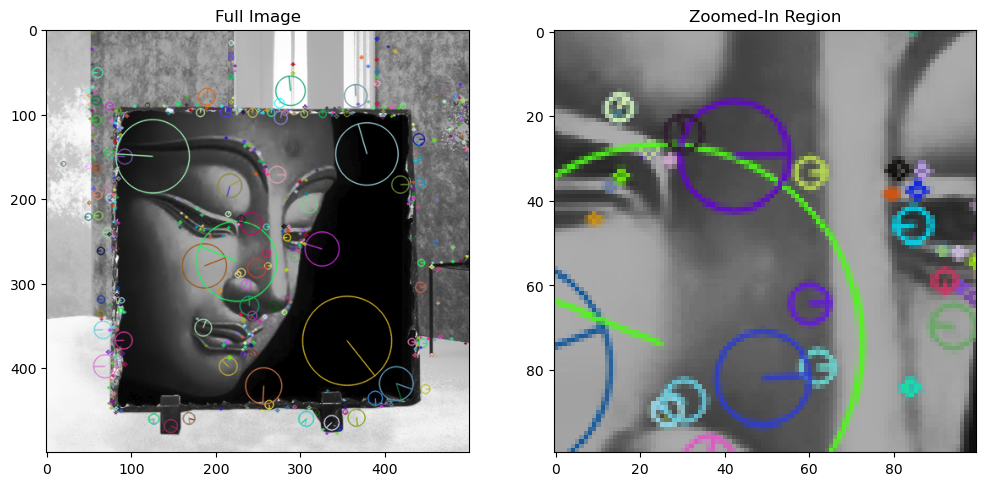

In [52]:
# Exemple avec les 500 best features 
compute_key_points_display_image(path, 
                                 methode= "liste_name_images", 
                                 data=None, 
                                 image_index = 15, 
                                 return_kp_des=False,
                                 plot=True,
                                 nfeatures=500
                                )

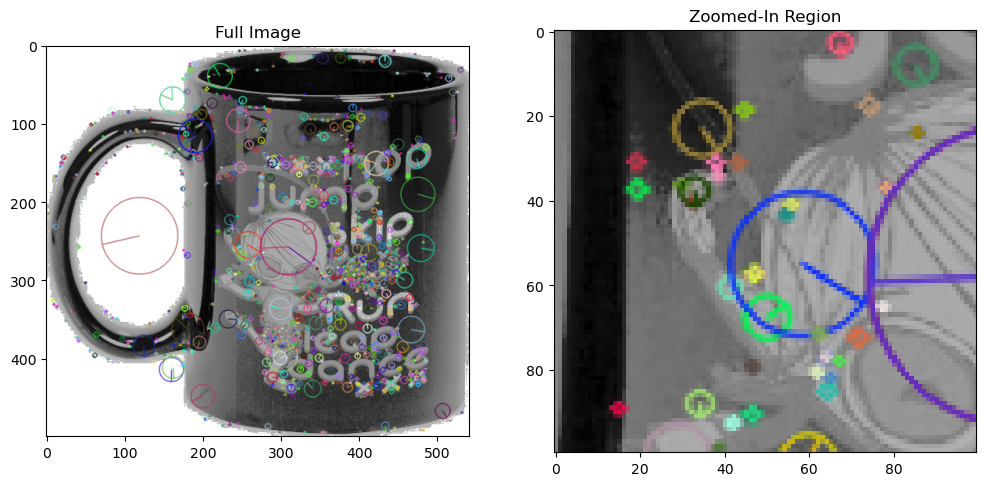

In [48]:
compute_key_points_display_image(path, 
                                 methode= "liste_name_images", 
                                 data=None, 
                                 image_index = 24, 
                                 return_kp_des=False,
                                 plot=True,
                                 nfeatures=0
                                )

### Création des descripteurs

In [135]:
sift_keypoints = []
t1 = time.time()

for i in tqdm(range(len(data['image']))):
              descriptors = compute_key_points_display_image(path,
                                               methode= "liste_name_images", 
                                               data=None, 
                                               image_index = i, 
                                               return_kp_des=True,
                                               plot=False,
                                               nfeatures=1000
                                              )
              sift_keypoints.append(descriptors)
t2 = time.time()

100%|██████████| 1050/1050 [01:29<00:00, 11.76it/s]


In [47]:
sift_keypoints

[array([[ 63.,  61.,   3., ...,   1.,   2.,   1.],
        [ 31.,   0.,   0., ...,   4.,   6.,   6.],
        [  5.,  81., 116., ...,  18.,   3.,   1.],
        ...,
        [  0.,   1.,  22., ...,   6.,   2.,  39.],
        [  7.,   9.,  21., ...,   8., 134.,  29.],
        [  0.,   0., 103., ...,  14.,  41.,  60.]], dtype=float32),
 array([[62., 21.,  0., ...,  0.,  0.,  0.],
        [91., 11.,  0., ...,  0.,  0.,  0.],
        [35.,  0.,  0., ...,  1.,  0.,  1.],
        ...,
        [15.,  0.,  0., ...,  0.,  0., 18.],
        [19., 41., 53., ..., 18., 88., 77.],
        [ 1.,  6., 38., ..., 20.,  9.,  8.]], dtype=float32),
 array([[ 4.,  9., 11., ...,  5.,  9., 11.],
        [ 9., 14., 11., ...,  7.,  2.,  9.],
        [32., 60., 42., ..., 11., 18.,  6.],
        ...,
        [57., 14., 14., ..., 48., 70., 56.],
        [25., 36.,  7., ..., 23., 25., 35.],
        [12., 60., 15., ...,  8., 10., 21.]], dtype=float32),
 array([[ 14.,   1.,   0., ...,   0.,   0.,   2.],
        [  0.

In [136]:
sift_keypoints_by_img = np.asarray(sift_keypoints, dtype= 'object')
sift_keypoints_all    = np.concatenate(sift_keypoints_by_img, axis=0)

In [137]:
print()
print("Nombre de descripteurs : ", sift_keypoints_all.shape)
duration1=time.time()-temps1
print("temps de traitement SIFT descriptor : ", "%15.2f" % duration1, "secondes")


Nombre de descripteurs :  (810592, 128)
temps de traitement SIFT descriptor :           925.69 secondes


### Création des clusters de descripteurs

In [138]:
# Determination number of clusters
temps1=time.time()

k = int(round(np.sqrt(len(sift_keypoints_all)),0))
print("Nombre de clusters estimés : ", k)
print("Création de",k, "clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
kmeans.fit(sift_keypoints_all)

duration1=time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")

Nombre de clusters estimés :  900
Création de 900 clusters de descripteurs ...


C:\Users\Lenovo\AppData\Roaming\Python\Python310\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


temps de traitement kmeans :            14.70 secondes


### Création des features des images

In [139]:
# Creation of histograms (features)
temps1=time.time()

def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Creation of a matrix of histograms
hist_vectors=[]

for i, image_desc in enumerate(sift_keypoints_by_img) :
    if i%100 == 0 : print(i)  
    hist = build_histogram(kmeans, image_desc, i) #calculates the histogram
    hist_vectors.append(hist) #histogram is the feature vector

im_features = np.asarray(hist_vectors)

duration1=time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")


0
100
200
300
400
500
600
700
800
900
1000
temps de création histogrammes :             5.86 secondes


### Réductions de dimension

#### Réduction de dimension PCA
* La réduction PCA permet de créer des features décorrélées entre elles, et de diminuer leur dimension, tout en gardant un niveau de variance expliquée élevé (99%)
* L'impact est une meilleure séparation des données via le T-SNE et une réduction du temps de traitement du T-SNE

In [140]:
print("Dimensions dataset avant réduction PCA : ", im_features.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca= pca.fit_transform(im_features)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 900)
Dimensions dataset après réduction PCA :  (1050, 602)


#### Réduction de dimension T-SNE
* Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images

In [53]:
data

,uniq_id,product_category_1,image,description_bow,description_bow_lem
0,55b85ea15a1536d46b7190ad6fff8ce7,Home Furnishing,55b85ea15a1536d46b7190ad6fff8ce7.jpg,key features elegance polyester multicolor abs...,key feature elegance polyester multicolor abst...
1,7b72c92c2f6c40268628ec5f14c6d590,Baby Care,7b72c92c2f6c40268628ec5f14c6d590.jpg,specifications sathiyas cotton bath towel bath...,specification sathiyas cotton bath towel bath ...
2,64d5d4a258243731dc7bbb1eef49ad74,Baby Care,64d5d4a258243731dc7bbb1eef49ad74.jpg,key features eurospa cotton terry face towel s...,key feature eurospa cotton terry face towel se...
3,d4684dcdc759dd9cdf41504698d737d8,Home Furnishing,d4684dcdc759dd9cdf41504698d737d8.jpg,key features santosh royal fashion cotton prin...,key feature santosh royal fashion cotton print...
4,6325b6870c54cd47be6ebfbffa620ec7,Home Furnishing,6325b6870c54cd47be6ebfbffa620ec7.jpg,key features jaipur print cotton floral king s...,key feature jaipur print cotton floral king si...
...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,Baby Care,958f54f4c46b53c8a0a9b8167d9140bc.jpg,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...
1046,fd6cbcc22efb6b761bd564c28928483c,Baby Care,fd6cbcc22efb6b761bd564c28928483c.jpg,wallmantra large vinyl sticker sticker pack pr...,wallmantra large vinyl sticker sticker pack pr...
1047,5912e037d12774bb73a2048f35a00009,Baby Care,5912e037d12774bb73a2048f35a00009.jpg,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,Baby Care,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...


In [152]:
PERPLEX = np.linspace(5, 70, 5, dtype=int)
LR = np.linspace(10, 1000, 5, dtype=int)
l_cat = list(set(data['product_category_1']))
n_clusters = len(l_cat)

kmeans = KMeans(n_clusters= n_clusters, max_iter= 300, n_init= 10,init= 'k-means++', algorithm= 'auto' )

fine_tune_tsne_parametre(PERPLEX, LR, cls=kmeans, train = feat_pca, to_array=False)

,learning_rate,perplexity,TIME_,ARI_
22,505,70,17.0,0.001104
8,752,21,10.0,0.000028
19,1000,53,12.0,-0.000178
13,752,37,13.0,-0.000447
15,10,53,14.0,-0.000583
16,257,53,12.0,-0.000924
23,752,70,13.0,-0.000981
17,505,53,15.0,-0.001002
9,1000,21,10.0,-0.001068
11,257,37,12.0,-0.001083


In [160]:
categories_column = data['product_category_1']
n_clusters = len(categories_column.unique())
ARI, X_tsne, clusters =  calcul_tsne_ari(feat_pca, pr_l = 70, lr_r=505, n_c =n_clusters, to_array=False, categories_column=categories_column)

ARI :  -0.001353964183617647


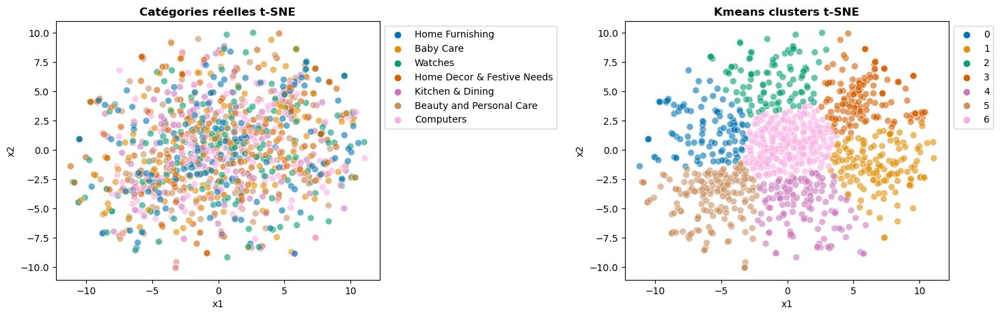

In [164]:
plot_tsne_clusters(X_tsne, clusters, categories_column)

## Transfer Learning 

Le transfert Learning consiste à utiliser les features  apprises (par des `modèles pré-entrainés`) sur un problème donné et à les exploiter sur un nouveau problème similaire. Par exemple, les features d'un modèle qui a appris à identifier les ratons laveurs peuvent être utiles pour démarrer un modèle destiné à identifier les tanukis. [source : Keras](https://keras.io/guides/transfer_learning/)

Le transfert learning, est généralement utilisé quand la taille de notre dataset contient trop peu de données pour entrainer un modèle à grande échelle.

Les grandes étapes du transfert learning son tels suivants : : 

1- Instanciez un modèle de base pré-entrainé et charger les poids .

2- Geler (freeze) toutes les couches dans le modèle de base en définissant `trainable = False.` 

3- Créer un nouveau modèle au-dessus de la sortie d'une (ou plusieurs) couches du modèle de base. 

3- Entraîner notre nouveau modèle sur l'ensemble de données. 

[The typical transfer-learning workflow](https://keras.io/guides/transfer_learning/#the-typical-transferlearning-workflow)

Et concernant l'extraction des features:

1- Instancier un modèle de base pré-entrainé et charger les poids.

2- Exécuter le nouveau jeu de données à travers celui-ci et enregistrer la sortie d'une (ou plusieurs) couches à partir du modèle de base.

3- Utiliser cette sortie comme données d'entrée pour un nouveau modèle plus petit.

L'un des principaux avantages de cette deuxième méthode est que on n'exécute le modèle de base qu'une seule fois sur les données, plutôt qu'une seule fois par période d'entraînement. C'est donc beaucoup plus rapide et moins coûteux temps/ressources.

`An issue with that second workflow, though, is that it doesn't allow you to dynamically modify the input data of your new model during training, which is required when doing data augmentation, for instance.` Transfer learning is typically used for tasks when your new dataset has too little data to train a full-scale model from scratch, and in such scenarios data augmentation is very important. So in what follows, we will focus on the first workflow.

### VGG16 

In [26]:
from tensorflow import keras
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras import Model

Le modèle atteint une précision de test de 92,7 % dans ImageNet, qui est un set de données images de plus de 14 millions d'images appartenant à 1000 classes, entrainé pendant des semaines avec NVIDIA Titan Black GPU's. 

ImageNet : Set de données de plus de 15 millions d'images haute résolution étiquetées appartenant à environ 22 000 catégories

#### base model

Tout d'abord, on instancie un modèle de base avec les poids pré-entrainés

Ensuite en enlève la dernière couche du réseau, qui est une couche de clasification dense avec 1000 neurones, qui correspond aux 1000 classes du jeu de données ImageNet. cette couche attribue une probabilité pour chaque photo de son appartenance à une classe donnée : avec `include_top= False`

In [19]:
vgg = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

Feature extraction
In this step, you will freeze the convolutional base created from the previous step and to use as a feature extractor. Additionally, you add a classifier on top of it and train the top-level classifier.

Freeze the convolutional base
It is important to freeze the convolutional base before you compile and train the model. Freezing (by setting layer.trainable = False) prevents the weights in a given layer from being updated during training. MobileNet V2 has many layers, so setting the entire model's trainable flag to False will freeze all of them.

In [20]:
# freez des poids de tous les layers
for layer in vgg.layers:
    layer.trainable = False

VGG16 est un réseau neuronal convolutif de 16 couches de profondeur, Nous utiliserons le modèle  pré-entraîné comme extracteur de features en utilisant les activations de couche comme features.

In [21]:
vgg.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

**Exemple de visualisation des résultat des filtres utilisés dans les premiers layers du réseau vgg16**

In [189]:
# Chemin d'accès aux images
path = r'C:\\Users\\Lenovo\\Documents\\DSPython\\P6_Classification\\data\\source\\P6_images_data_set\\'

In [190]:
# Récupération d'une image au hasard
img_path = path_image(path, image_index = 695)
img = load_img(img_path, target_size=(224, 224))
img_tensor = img_to_array(img)
img_tensor = img_tensor.reshape((img_tensor.shape[0], img_tensor.shape[1], img_tensor.shape[2]))
img_tensor = np.array(img_tensor)
img_tensor = preprocess_input(img_tensor)

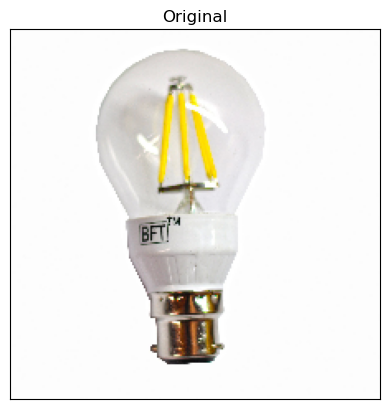

In [152]:
# Display de l'image via la fonction : display_image()
display_image(img, titre = "Original")

In [71]:
# Augmentation de la dimension
img_tensor = np.expand_dims(img_tensor, axis=0)

In [72]:
print(img_tensor.shape)

(1, 224, 224, 3)


In [73]:
vgg.layers[:8]

In [74]:
# Extraction des outputs des top 17 layers
layer_outputs = [layer.output for layer in vgg.layers[1:17]]

In [75]:
layer_outputs

[<KerasTensor: shape=(None, 224, 224, 64) dtype=float32 (created by layer 'block1_conv1')>,
 <KerasTensor: shape=(None, 224, 224, 64) dtype=float32 (created by layer 'block1_conv2')>,
 <KerasTensor: shape=(None, 112, 112, 64) dtype=float32 (created by layer 'block1_pool')>,
 <KerasTensor: shape=(None, 112, 112, 128) dtype=float32 (created by layer 'block2_conv1')>,
 <KerasTensor: shape=(None, 112, 112, 128) dtype=float32 (created by layer 'block2_conv2')>,
 <KerasTensor: shape=(None, 56, 56, 128) dtype=float32 (created by layer 'block2_pool')>,
 <KerasTensor: shape=(None, 56, 56, 256) dtype=float32 (created by layer 'block3_conv1')>,
 <KerasTensor: shape=(None, 56, 56, 256) dtype=float32 (created by layer 'block3_conv2')>,
 <KerasTensor: shape=(None, 56, 56, 256) dtype=float32 (created by layer 'block3_conv3')>,
 <KerasTensor: shape=(None, 28, 28, 256) dtype=float32 (created by layer 'block3_pool')>,
 <KerasTensor: shape=(None, 28, 28, 512) dtype=float32 (created by layer 'block4_conv1

In [76]:
# Modèle qui renvera les outputs selon les input du modèle de base
activation_model = models.Model(inputs=vgg.input, outputs= layer_outputs)

In [77]:
# Les activations 
activations = activation_model.predict(img_tensor)

1/1 [==============================] - 1s 1s/step


(1, 224, 224, 64)


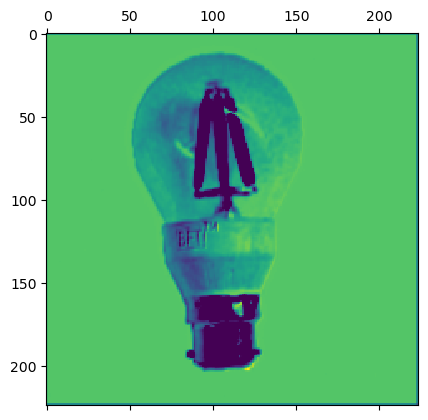

In [78]:
# Le premier Layer a 3 Couches
first_layer_activation = activations[0]
print(first_layer_activation.shape)

plt.matshow(first_layer_activation[0, :, :, 1], cmap='viridis')

(1, 112, 112, 64)


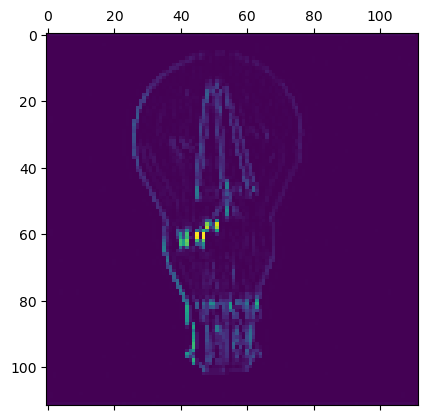

In [79]:
# Le deuxième Layers a 64 couches ou Channels
first_layer_activation = activations[2]
print(first_layer_activation.shape)

plt.matshow(first_layer_activation[0, :, :, 35], cmap='viridis')

Le code suivant est tiré du livre `DEEP LEARNING with Python François Chollet`

In [81]:
layer_names = []
for layer in vgg.layers[:8]:
    layer_names.append(layer.name)

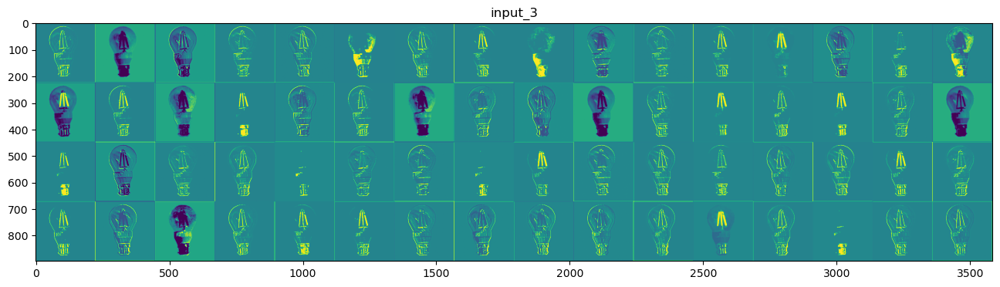

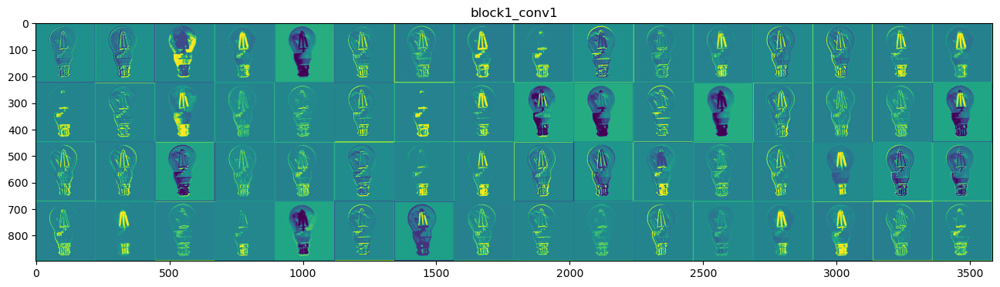

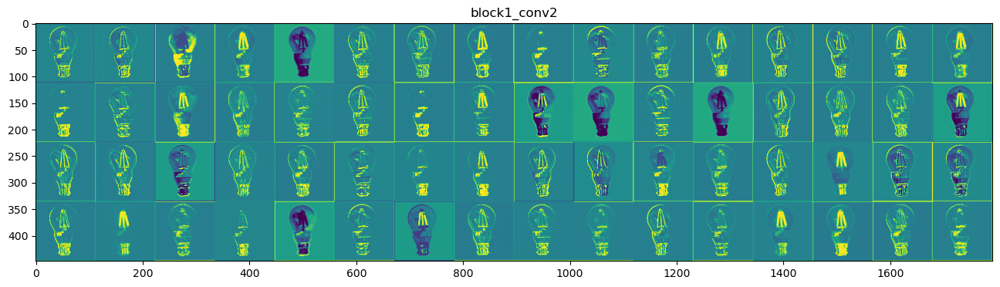

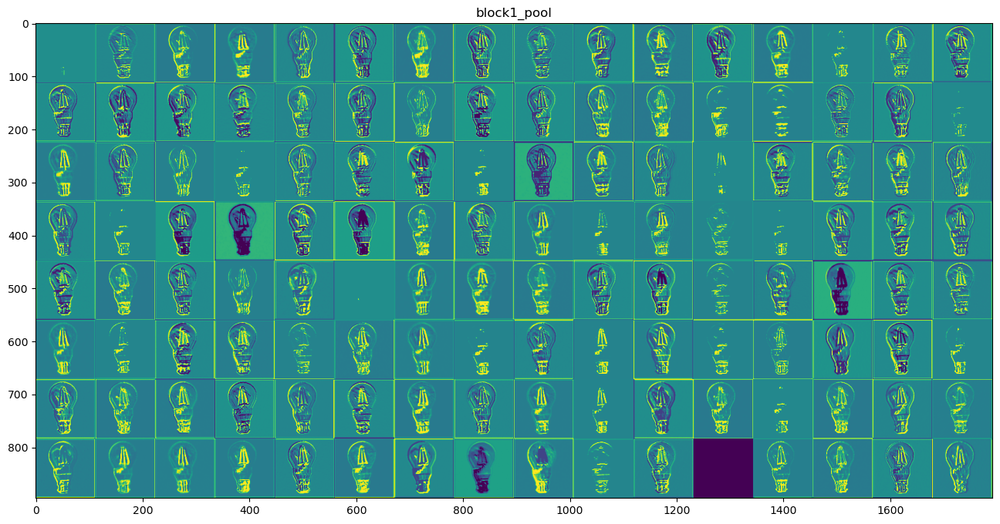

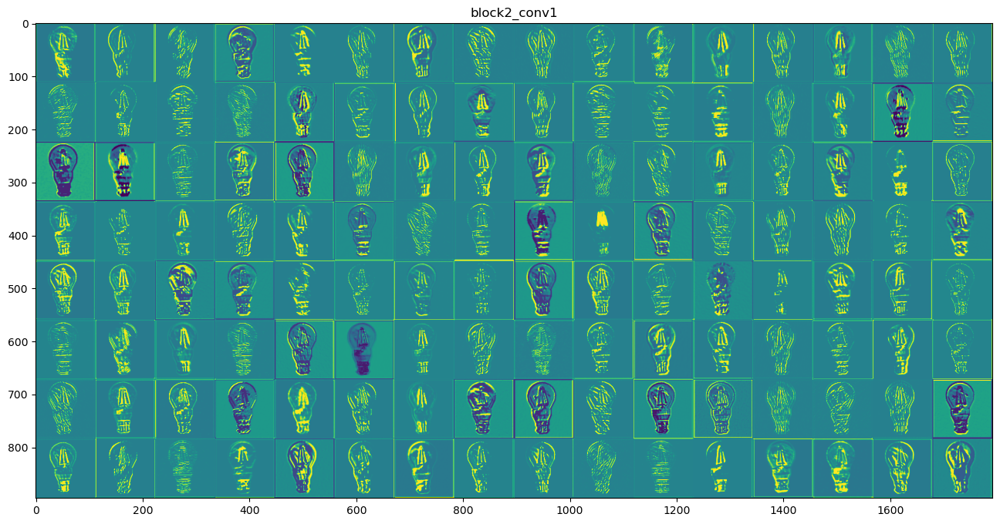

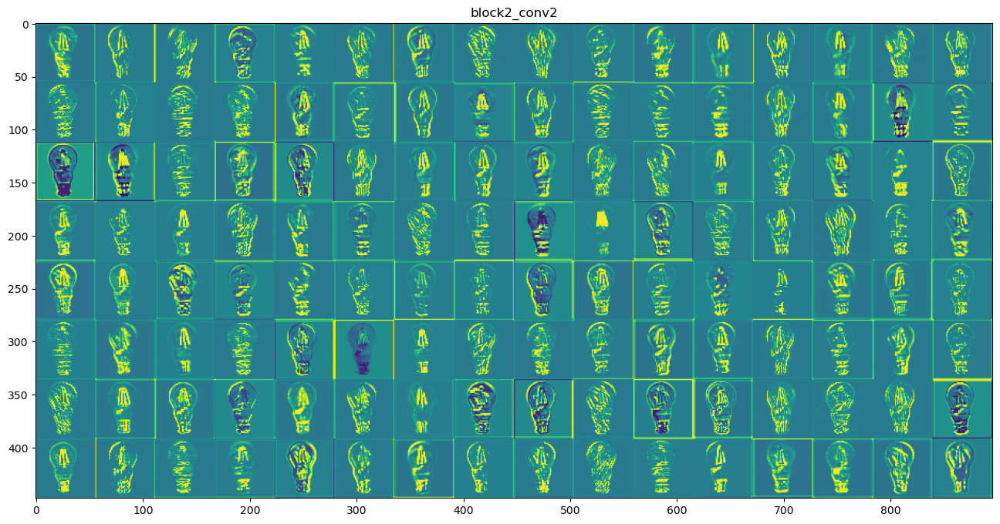

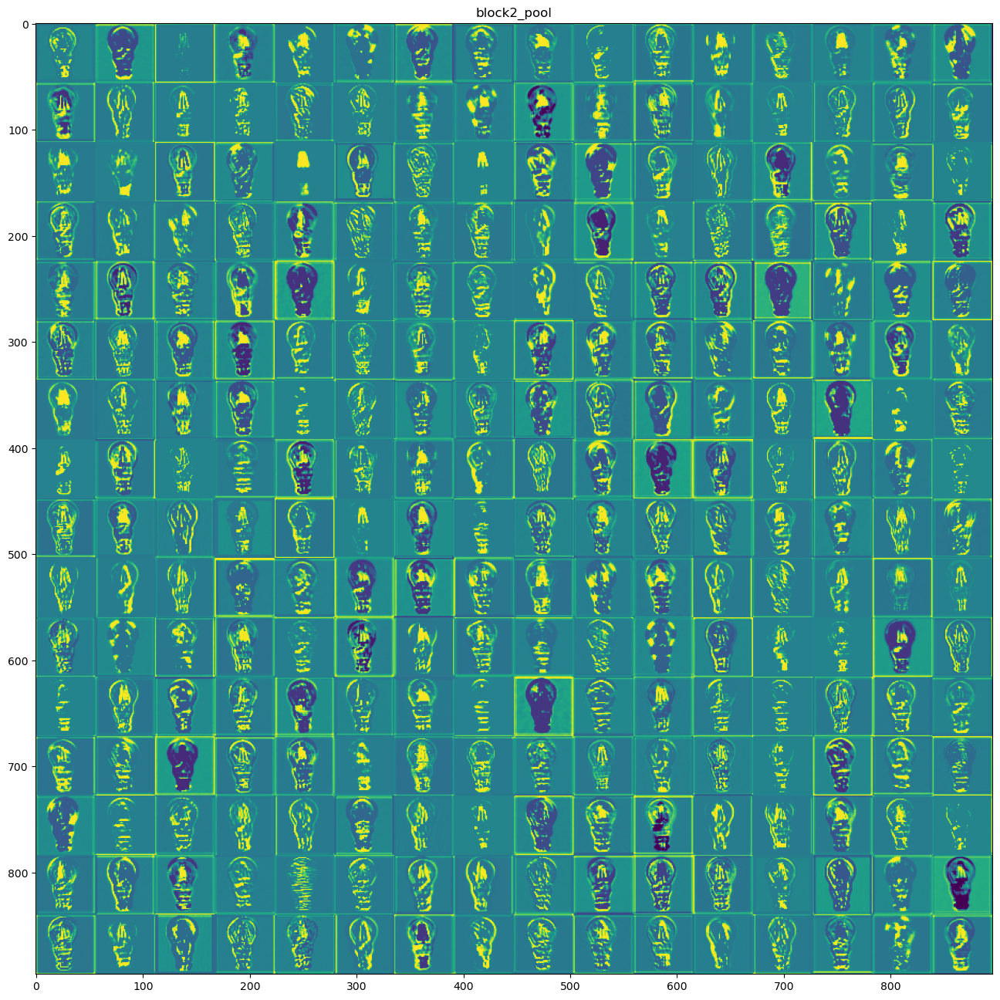

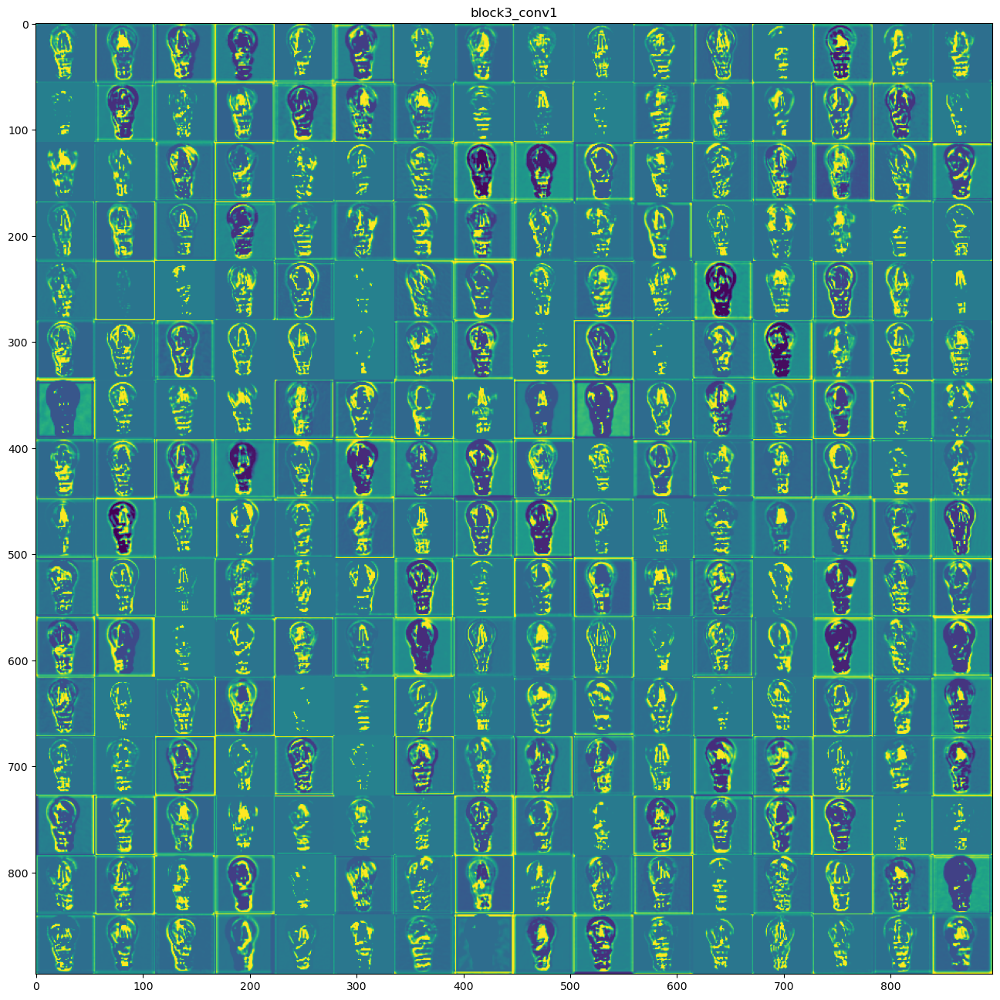

In [82]:
# Représentation graphiques des différentes couches pour chaque layers
# En quelque sorte la façon dont l'ordinateur voie les photos 

images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,:, :,col * images_per_row + row]
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

Nous allons à présent appliquer les étapes précédentes pour extraire les features pour toutes nos images. 

#### pre-process des images

In [24]:
def image_preprocessing_for_cnn(path, image_name_col):
    
    images = []
    
    for filename in image_name_col:
        img = load_img(path+filename, target_size=(224, 224))  
        img = img_to_array(img) 
        img = np.expand_dims(img, axis=0)
        img = preprocess_input(img)
        images.append(img)
    
    return images

In [23]:
path = "data/source/P6_images_data_set/"
img_name_col = list(data['image'].values)
images = image_preprocessing_for_cnn(path, img_name_col)

In [24]:
images = np.array(images)

In [25]:
images

array([[[[[  88.061     ,   87.221     ,   82.32      ],
          [  87.061     ,   86.221     ,   81.32      ],
          [  89.061     ,   85.221     ,   81.32      ],
          ...,
          [  53.060997  ,   49.221     ,   51.32      ],
          [  54.060997  ,   50.221     ,   52.32      ],
          [  53.060997  ,   49.221     ,   51.32      ]],

         [[  99.061     ,   91.221     ,   83.32      ],
          [  97.061     ,   89.221     ,   83.32      ],
          [  98.061     ,   90.221     ,   84.32      ],
          ...,
          [  56.060997  ,   52.221     ,   54.32      ],
          [  54.060997  ,   50.221     ,   52.32      ],
          [  55.060997  ,   51.221     ,   53.32      ]],

         [[  99.061     ,   90.221     ,   84.32      ],
          [ 103.061     ,   92.221     ,   86.32      ],
          [ 103.061     ,   92.221     ,   86.32      ],
          ...,
          [  55.060997  ,   51.221     ,   53.32      ],
          [  56.060997  ,   52.221     

In [26]:
images = np.concatenate(images, axis=0)

In [36]:
type(images)

numpy.ndarray

In [82]:
# J'enregistre ndarry pour une utilisation ultérieure
with open('./data/features_extracted/vgg16_Images.npy', 'wb') as f:
    np.save(f, images, allow_pickle=True)

In [19]:
# Pour importer les résultat du transfer learning 
with open('./data/features_extracted/vgg16_Images.npy', 'rb') as f:
    images = np.load(f, allow_pickle=True)

#### extraction des features 

In [27]:
# Création des features des images
features = vgg.predict(images)

33/33 [==============================] - 23s 300ms/step


In [21]:
features.shape

(1050, 25088)

In [29]:
# Extraction des features 
features = features.reshape(features.shape[0], -1)

In [30]:
# 
features.shape

(1050, 25088)

In [31]:
type(features)

numpy.ndarray

**save des vecteurs**

In [32]:
# J'enregistre les features pour une utilisation ultérieure
with open('./data/features_extracted/vgg16_Features.npy', 'wb') as f:
    np.save(f, features, allow_pickle=True)

In [18]:
# pour importer les features 
with open('./data/features_extracted/vgg16_Features.npy', 'rb') as f:
    features_vgg16 = np.load(f, allow_pickle=True)

### Réductions de dimension

#### ACP 

In [31]:
print("Dimensions dataset avant réduction PCA : ", features_vgg16.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca_vgg16 = pca.fit_transform(features_vgg16)
print("Dimensions dataset après réduction PCA : ", feat_pca_vgg16.shape)

Dimensions dataset avant réduction PCA :  (1050, 25088)
Dimensions dataset après réduction PCA :  (1050, 940)


#### Fine tuning TSNE 

In [32]:
# Initialisations : 

#----------TSNE hyperparam---------------: 
PERPLEX = np.linspace(5, 70, 5, dtype=int)
LR = np.linspace(10, 1000, 5, dtype=int)

#-------n catégories---------------------:
l_cat = list(set(data['product_category_1']))
n_clusters = len(l_cat)
categories_column = data['product_category_1']

#----------KMeans------------------------:
kmeans = KMeans(n_clusters= n_clusters, max_iter= 300, n_init= 10,init= 'k-means++', algorithm= 'auto' )

In [33]:
# avec les données réduites
fine_tune_tsne_parametre(PERPLEX, LR, cls=kmeans, train = feat_pca_vgg16, to_array=False)

,learning_rate,perplexity,TIME_,ARI_
21,257,70,16.0,0.309173
9,1000,21,10.0,0.306872
20,10,70,16.0,0.304113
16,257,53,15.0,0.303967
22,505,70,17.0,0.303869
23,752,70,17.0,0.296313
14,1000,37,13.0,0.295524
11,257,37,12.0,0.289521
19,1000,53,15.0,0.285134
13,752,37,14.0,0.282956


In [34]:
# Calcul TSNE  
ARI, X_tsne, clusters =  calcul_tsne_ari(feat_pca_vgg16, pr_l = 70, lr_r= 257, n_c =n_clusters, to_array=False, categories_column=categories_column)

ARI :  0.3083438375801817


#### Plot clusters

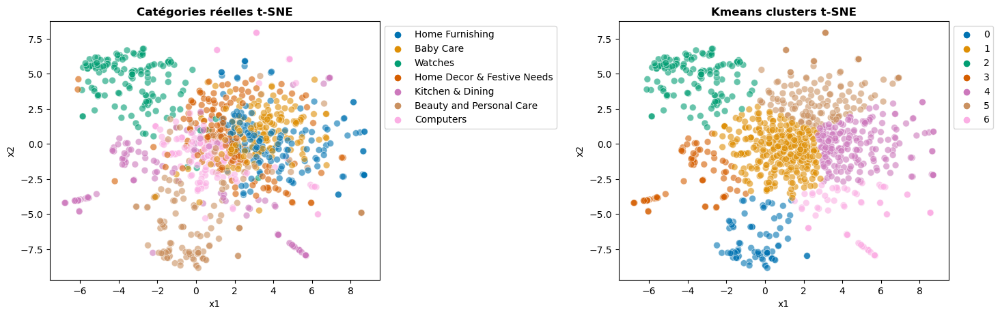

In [35]:
# Représentation graphique
plot_tsne_clusters(X_tsne, clusters, categories_column)

# Image + Text 

À présent, nous allons concaténer les résultats obtenus dans les deux parties Texte et Images, afin de voir si ceci améliore les résultats obtenus. 

In [36]:
with open('./data/features_extracted/TF_IDF_lemm_Features.npy', 'rb') as f:
    a = np.load(f, allow_pickle=True)

In [37]:
with open('./data/features_extracted/vgg16_Features.npy', 'rb') as f:
    b = np.load(f, allow_pickle=True)

In [38]:
a.shape

(1050, 4250)

In [39]:
b.shape

(1050, 25088)

In [40]:
c = np.concatenate((a, b), axis=1)

In [41]:
c.shape

(1050, 29338)

### Réductions de dimension

#### ACP 

In [42]:
print("Dimensions dataset avant réduction PCA : ", c.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca_text_vgg16 = pca.fit_transform(c)
print("Dimensions dataset après réduction PCA : ", feat_pca_text_vgg16.shape)

Dimensions dataset avant réduction PCA :  (1050, 29338)
Dimensions dataset après réduction PCA :  (1050, 940)


#### Fine tuning TSNE 

In [43]:
# avec les données réduites
fine_tune_tsne_parametre(PERPLEX, LR, cls=kmeans, train = feat_pca_text_vgg16, to_array=False)

,learning_rate,perplexity,TIME_,ARI_
9,1000,21,10.0,0.324332
22,505,70,16.0,0.316106
13,752,37,12.0,0.312615
20,10,70,16.0,0.307820
7,505,21,10.0,0.305984
11,257,37,11.0,0.300243
16,257,53,14.0,0.298843
17,505,53,15.0,0.296930
19,1000,53,15.0,0.294627
14,1000,37,12.0,0.292430


In [44]:
# Calcul TSNE  
ARI, X_tsne, clusters =  calcul_tsne_ari(feat_pca_text_vgg16, pr_l = 21 , lr_r= 1000, n_c =n_clusters, to_array=False, categories_column=categories_column)

ARI :  0.320696618600452


#### Plot clusters

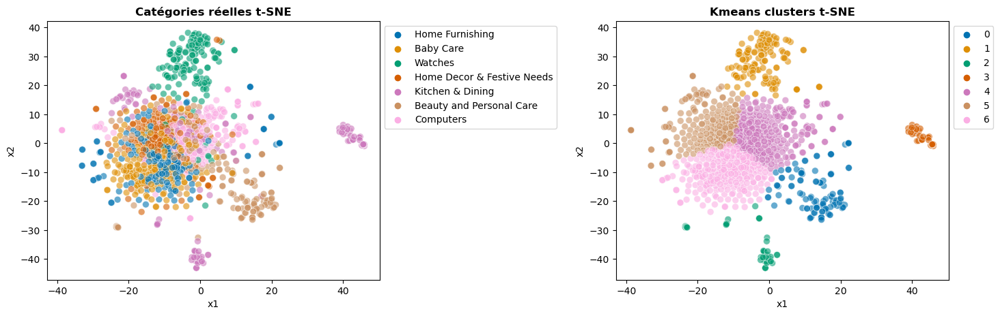

In [45]:
# Représentation graphique
plot_tsne_clusters(X_tsne, clusters, categories_column)